
image 1/1 /Users/marcus/SubwaySurfers/train_screenshots/frame_0200.jpg: 864x1504 1 GREYTRAIN, 1 HIGHBARRIER1, 2 ORANGETRAINs, 3 Railss, 2 YELLOWTRAINs, 318.5ms
Speed: 10.6ms preprocess, 318.5ms inference, 19.8ms postprocess per image at shape (1, 3, 864, 1504)

image 1/1 /Users/marcus/SubwaySurfers/train_screenshots/frame_0200.jpg: 864x1504 1 GREYTRAIN, 1 HIGHBARRIER1, 2 ORANGETRAINs, 3 Railss, 2 YELLOWTRAINs, 252.6ms
Speed: 31.3ms preprocess, 252.6ms inference, 17.0ms postprocess per image at shape (1, 3, 864, 1504)


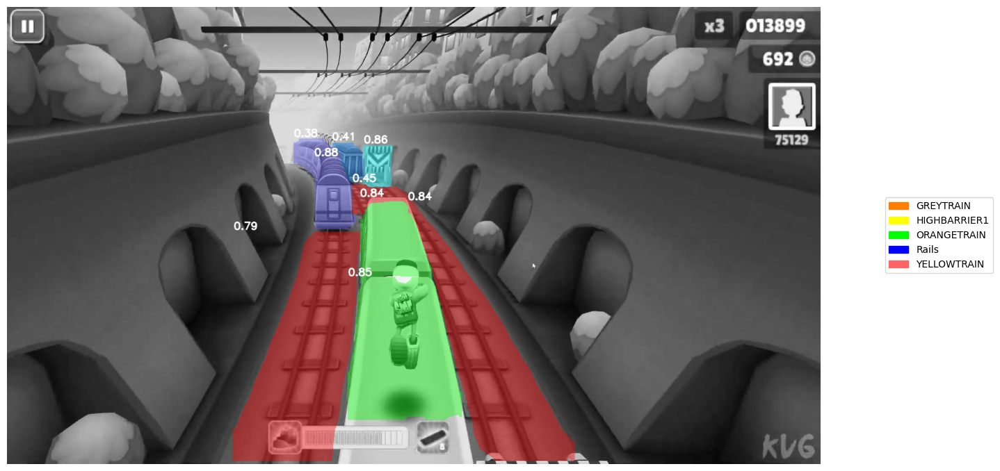

In [1]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Patch
from ultralytics import YOLO

home    = os.path.expanduser("~")
weights = f"{home}/models/jakes-loped/jakes-finder-mk1/1/weights.pt"

# ─── 0) MODEL INSTANTIATION & WARM-UP ───────────────────────────────────────────
model = YOLO(weights)
# warm-up on one sample so kernels are JIT-compiled
sample_path = f"{home}/SubwaySurfers/train_screenshots/frame_0200.jpg"
_ = model.predict(source=sample_path, task="segment", conf=0.30, iou=0.45)
# ────────────────────────────────────────────────────────────────────────────────

def cycle(j, i):
    img_path = f"{home}/SubwaySurfers/train_screenshots/frame_02{j}{i}.jpg"
    results  = model.predict(source=img_path, task="segment", conf=0.30, iou=0.45)[0]

    # get masks, classes, boxes & confidences
    polygons    = results.masks.xy
    class_ids   = results.boxes.cls.cpu().numpy().astype(int)
    confidences = results.boxes.conf.cpu().numpy()
    boxes       = results.boxes.xyxy.cpu().numpy().astype(int)
    names       = results.names

    # build gray background
    img_color = cv2.imread(img_path)
    img_gray  = cv2.cvtColor(img_color, cv2.COLOR_BGR2GRAY)
    bg_gray3  = cv2.cvtColor(img_gray, cv2.COLOR_GRAY2BGR)

    # assign colors per class
    unique_ids    = sorted(set(class_ids))
    custom_colors = {1:(255,128,0), 6:(0,255,0), 9:(0,0,255), 11:(255,100,100)}
    color_map     = {cid: custom_colors.get(cid,(255,255,0)) for cid in unique_ids}

    # render masks
    overlay = bg_gray3.copy()
    for poly, cid in zip(polygons, class_ids):
        pts = poly.astype(np.int32).reshape(-1,1,2)
        cv2.fillPoly(overlay, [pts], color_map[cid])
    blended = cv2.addWeighted(overlay, 0.4, bg_gray3, 0.6, 0)



#######CONFIDENCE INTERVAL DISPLAY ##################################################
    # draw each confidence just above its mask's bbox
    for conf, box in zip(confidences, boxes):
        x1, y1 = box[0], box[1]
        label  = f"{conf:.2f}"
        cv2.putText(
            blended, label, (int(x1), int(y1)-5),
            cv2.FONT_HERSHEY_SIMPLEX, 0.8, (255,255,255), 2, cv2.LINE_AA
        )
#################################################################
    # display


    fig, ax = plt.subplots(figsize=(12,8))
    ax.imshow(cv2.cvtColor(blended, cv2.COLOR_BGR2RGB))
    ax.axis(False)

    # legend
    patches = [Patch(color=np.array(color_map[cid])/255.0, label=names[cid])
               for cid in unique_ids]
    fig.legend(handles=patches, loc="center right", bbox_to_anchor=(1.2,0.5))
    plt.tight_layout()
    plt.show()


# now this loop will be much faster AND annotate confidences
for i in range(1):
    for j in range(1):
        cycle(j, i)


✅ Using device: mps
Loading pretrain weights


Model is not optimized for inference. Latency may be higher than expected. You can optimize the model for inference by calling model.optimize_for_inference().


▶ Processing frame_0000.jpg on mps


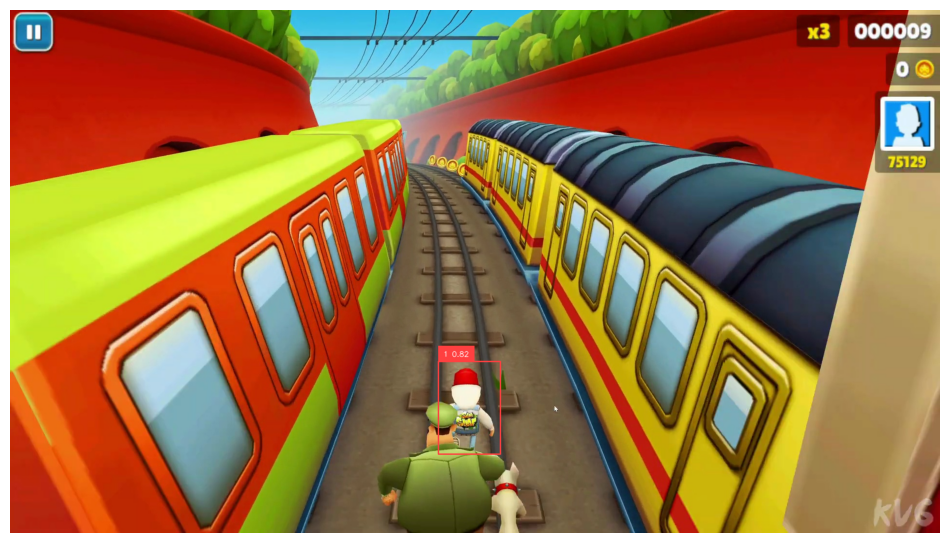

✅ Inference time: 17548.92 ms

▶ Processing frame_0010.jpg on mps


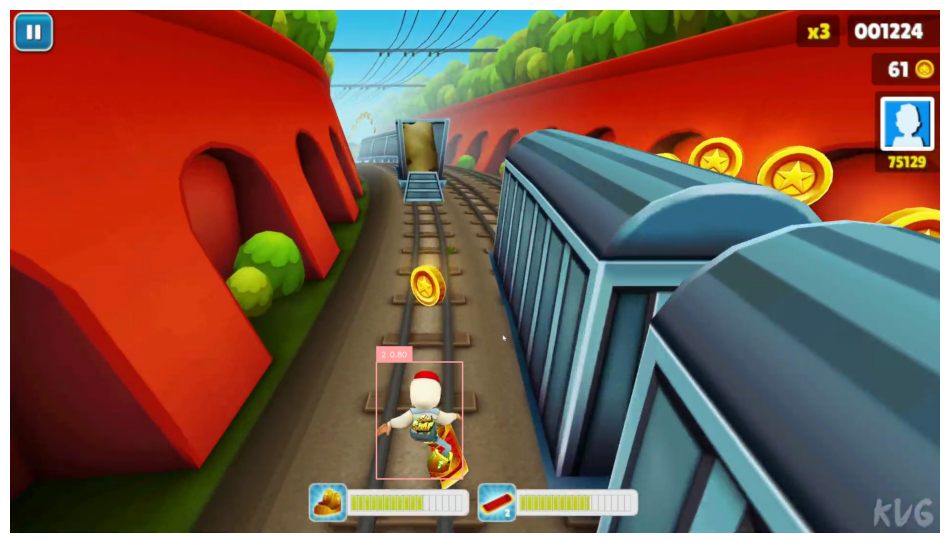

✅ Inference time: 311.00 ms

▶ Processing frame_0020.jpg on mps


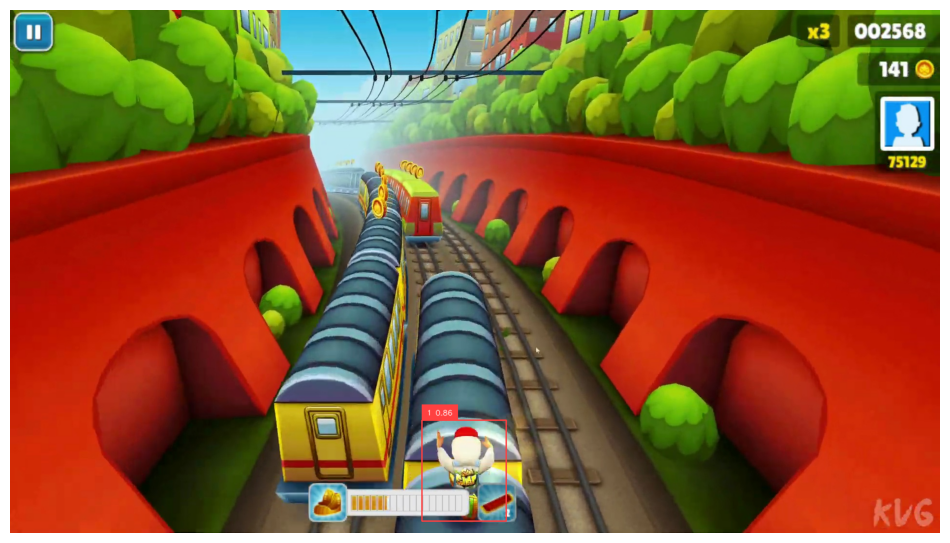

✅ Inference time: 205.19 ms

▶ Processing frame_0030.jpg on mps


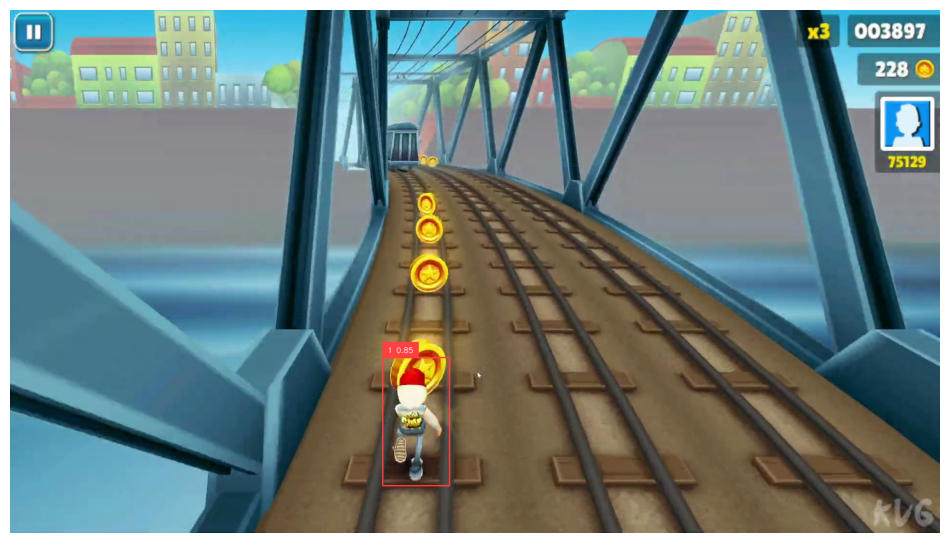

✅ Inference time: 159.50 ms

▶ Processing frame_0040.jpg on mps


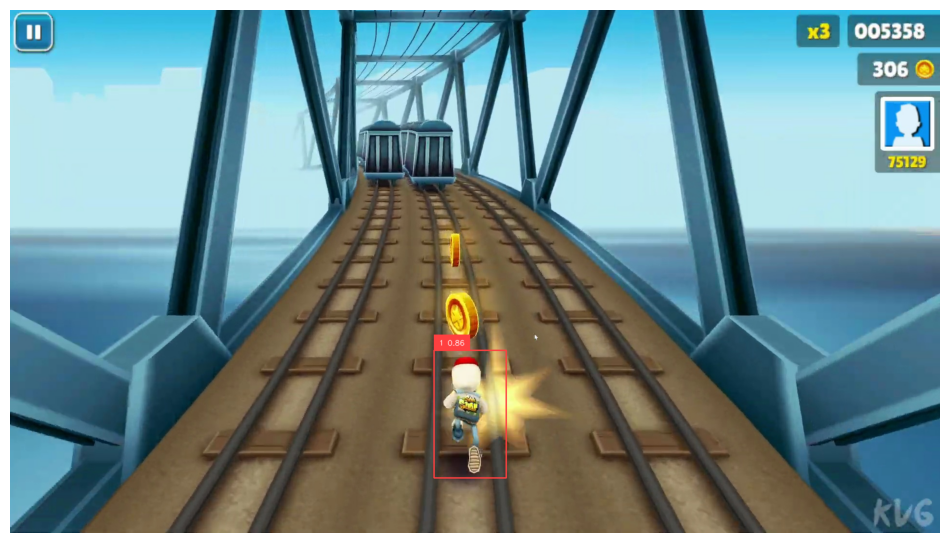

✅ Inference time: 220.40 ms

▶ Processing frame_0050.jpg on mps


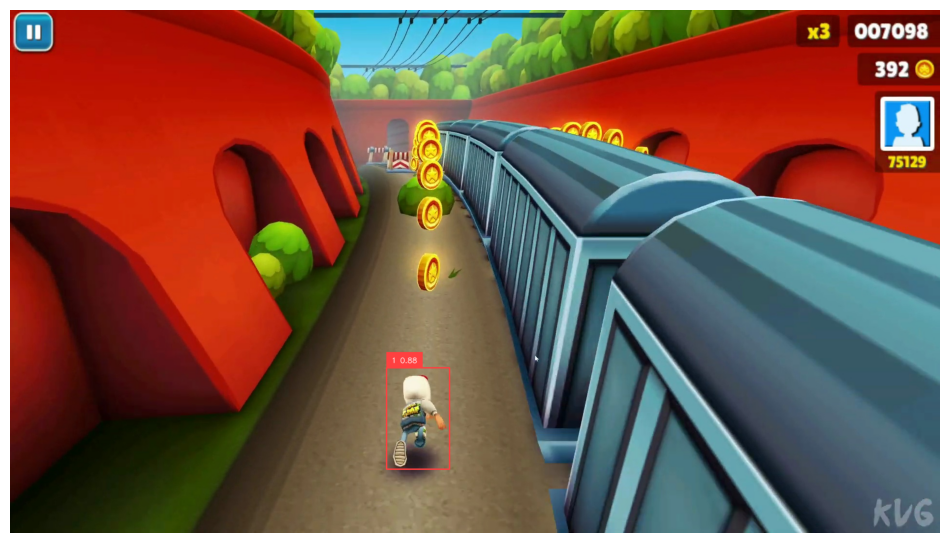

✅ Inference time: 161.56 ms

▶ Processing frame_0060.jpg on mps


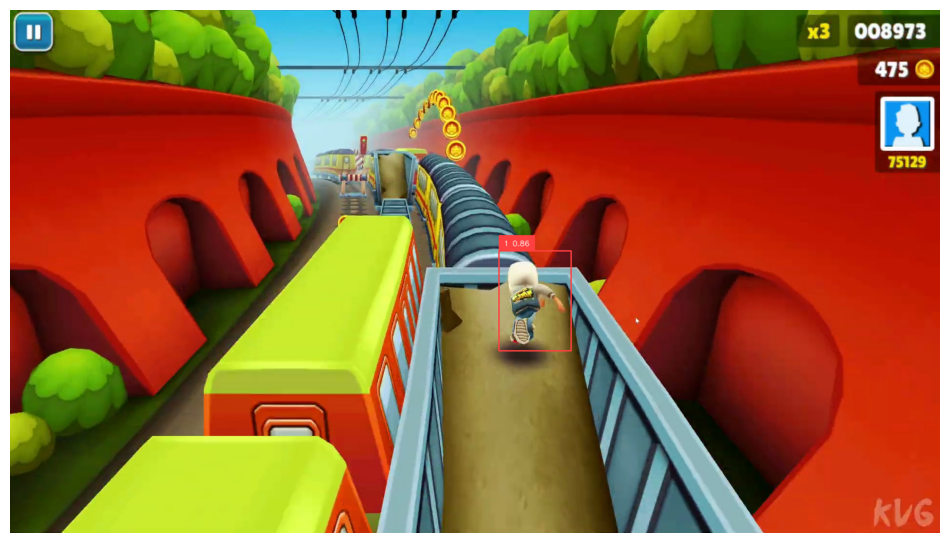

✅ Inference time: 173.34 ms

▶ Processing frame_0070.jpg on mps


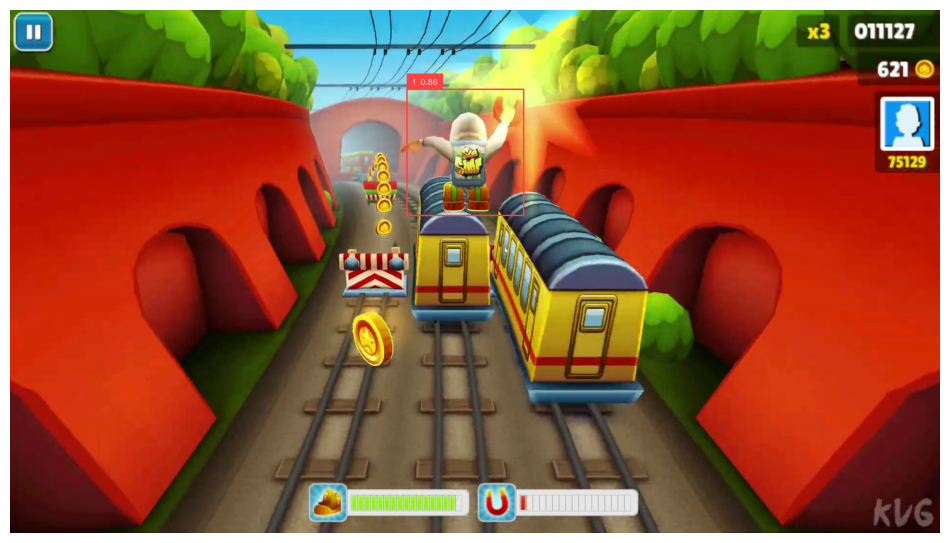

✅ Inference time: 164.15 ms

▶ Processing frame_0080.jpg on mps


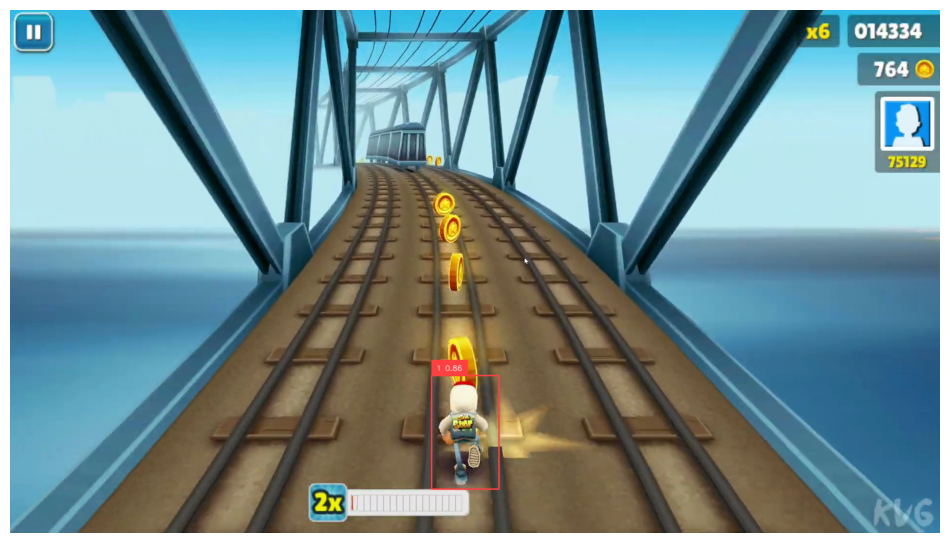

✅ Inference time: 184.36 ms

▶ Processing frame_0001.jpg on mps


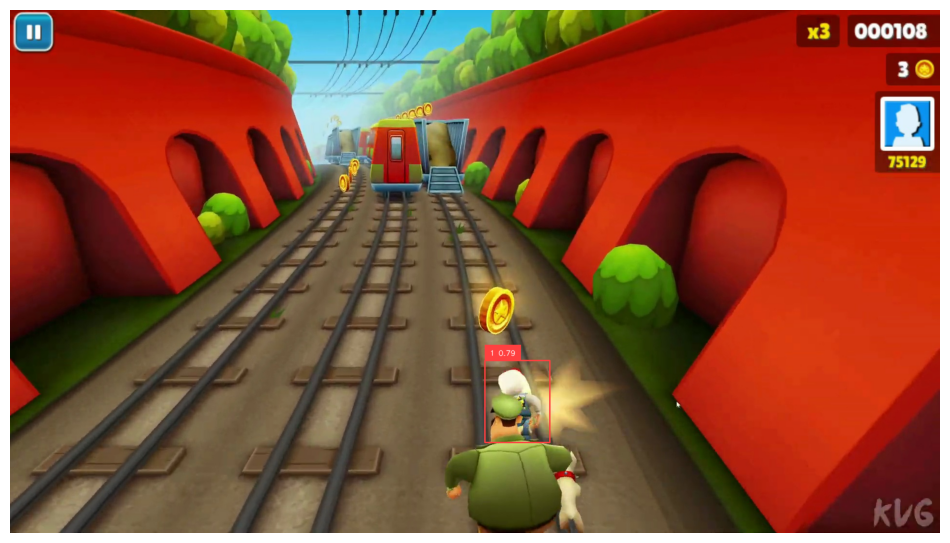

✅ Inference time: 152.56 ms

▶ Processing frame_0011.jpg on mps


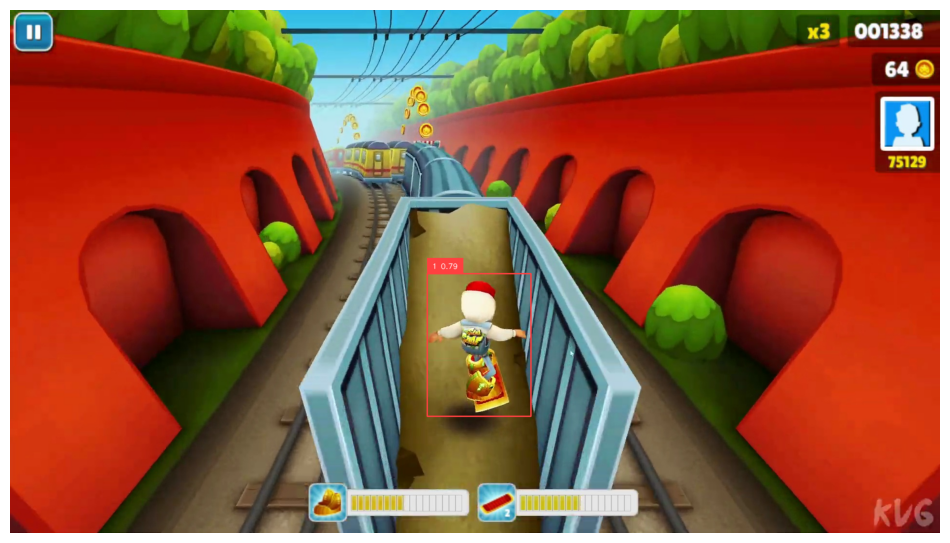

✅ Inference time: 153.12 ms

▶ Processing frame_0021.jpg on mps


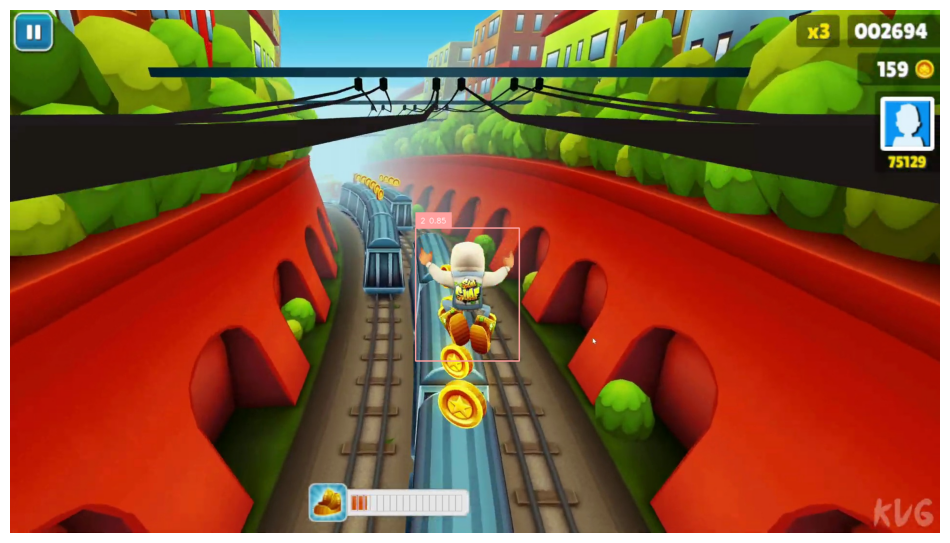

✅ Inference time: 150.80 ms

▶ Processing frame_0031.jpg on mps


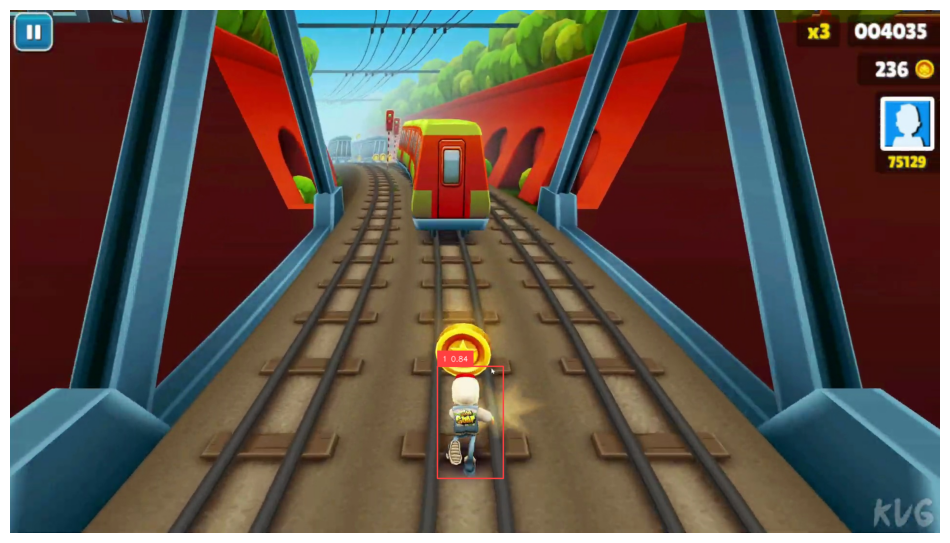

✅ Inference time: 161.96 ms

▶ Processing frame_0041.jpg on mps


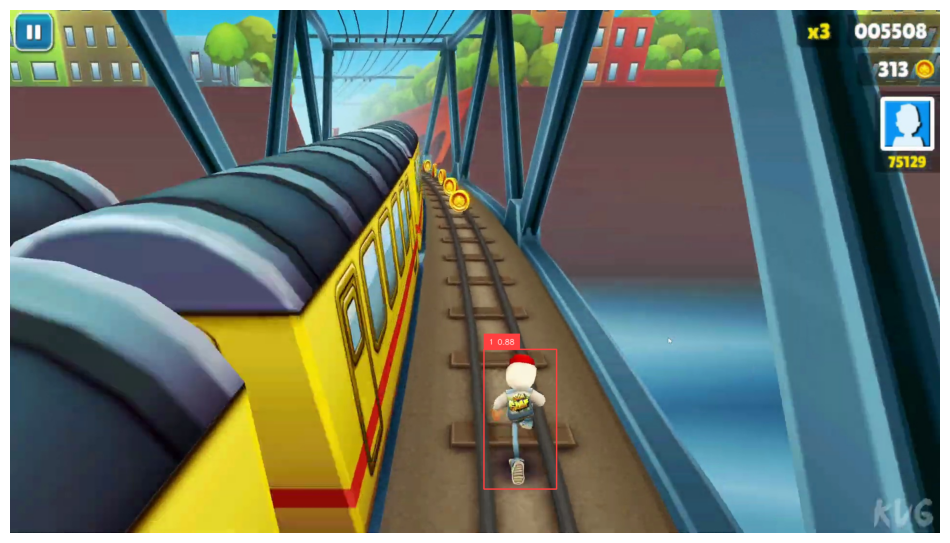

✅ Inference time: 154.06 ms

▶ Processing frame_0051.jpg on mps


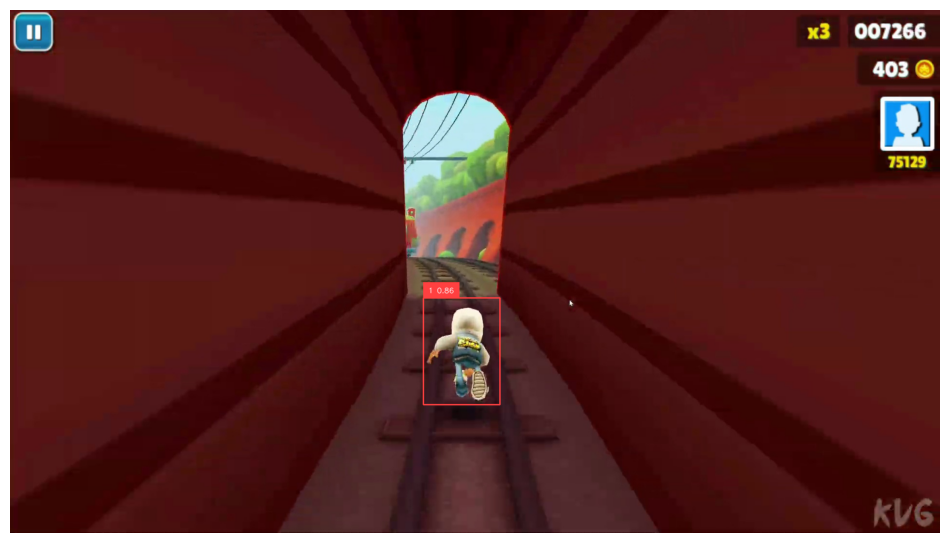

✅ Inference time: 252.69 ms

▶ Processing frame_0061.jpg on mps


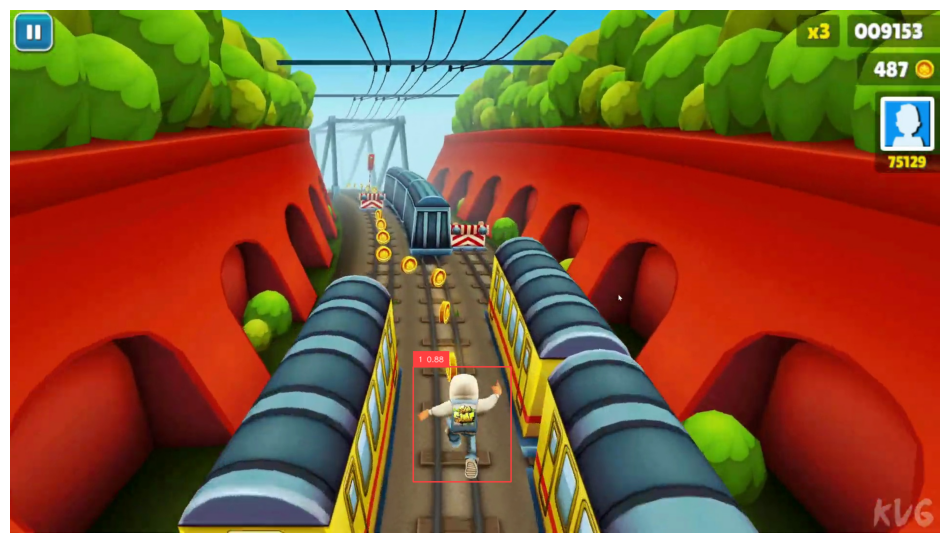

✅ Inference time: 283.31 ms

▶ Processing frame_0071.jpg on mps


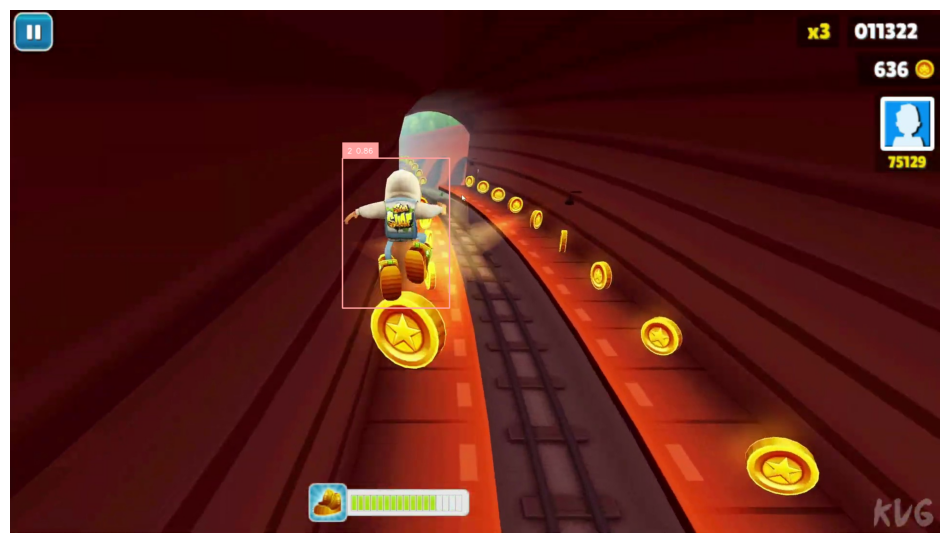

✅ Inference time: 189.60 ms

▶ Processing frame_0081.jpg on mps


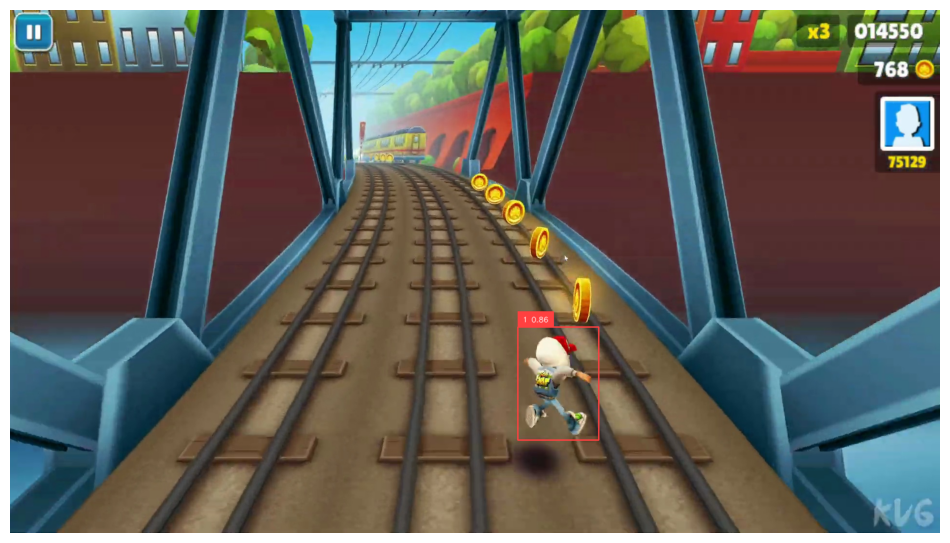

✅ Inference time: 226.27 ms

▶ Processing frame_0002.jpg on mps


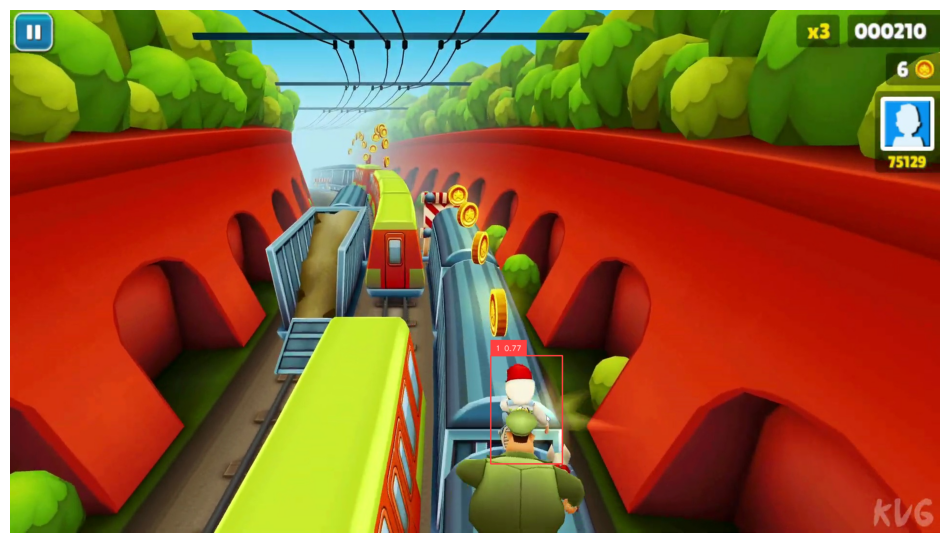

✅ Inference time: 237.45 ms

▶ Processing frame_0012.jpg on mps


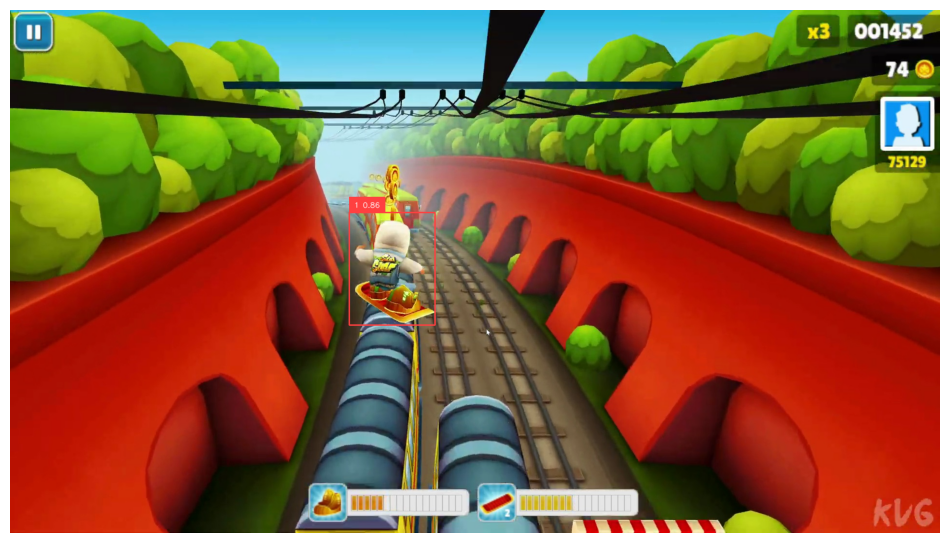

✅ Inference time: 204.95 ms

▶ Processing frame_0022.jpg on mps


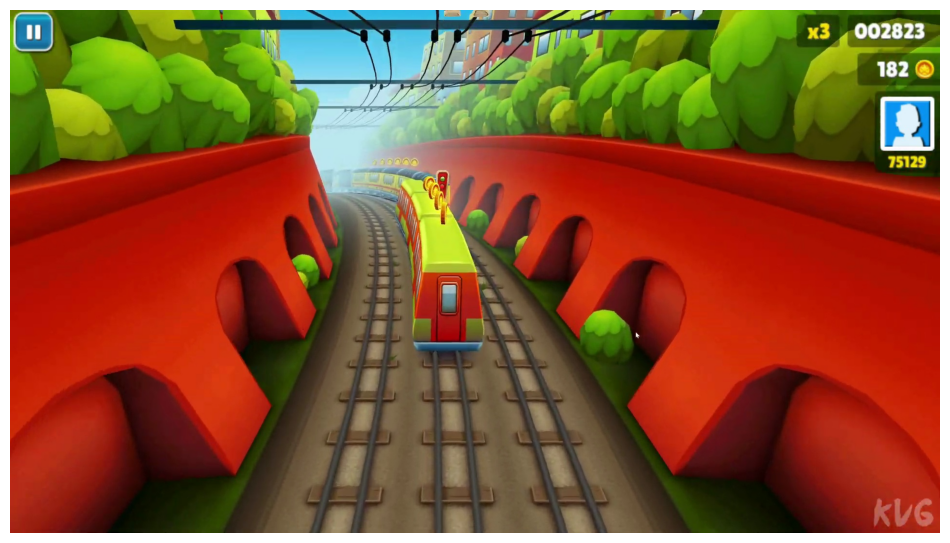

✅ Inference time: 207.93 ms

▶ Processing frame_0032.jpg on mps


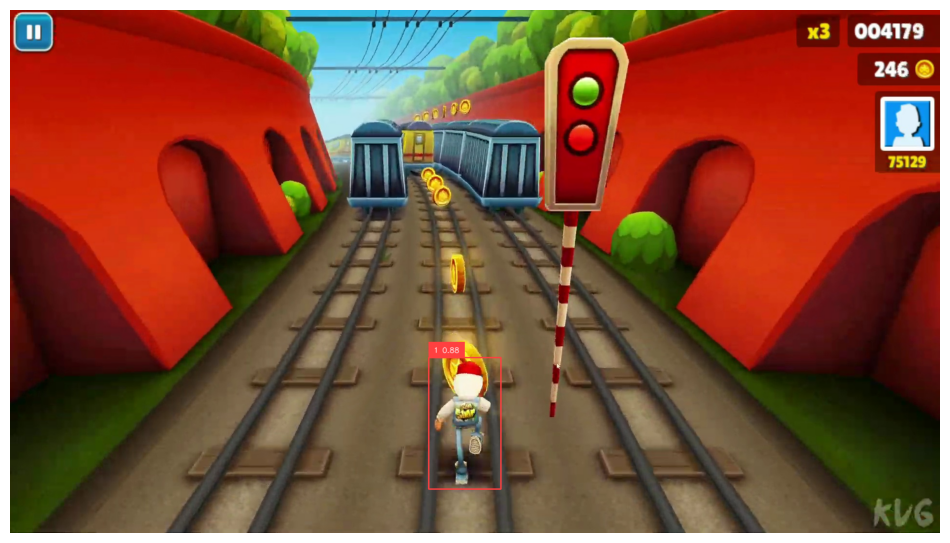

✅ Inference time: 182.16 ms

▶ Processing frame_0042.jpg on mps


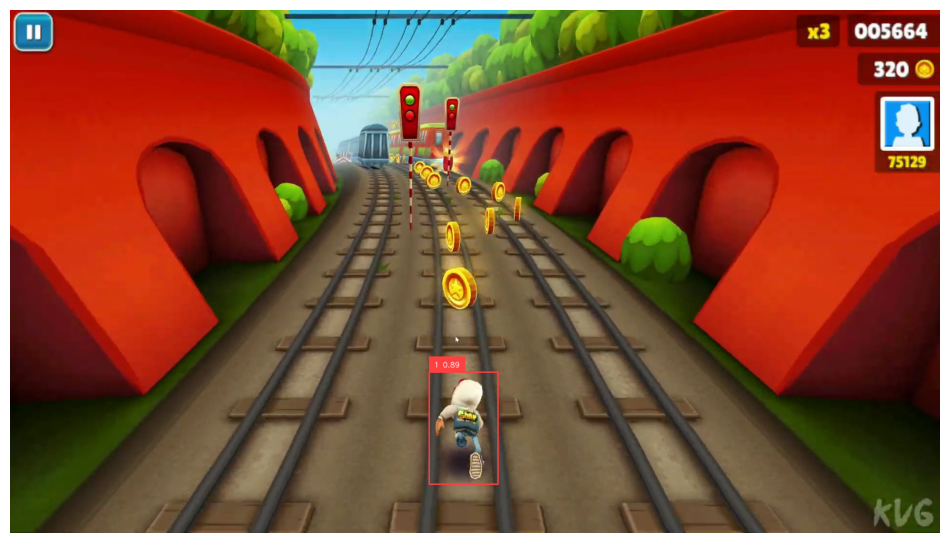

✅ Inference time: 268.81 ms

▶ Processing frame_0052.jpg on mps


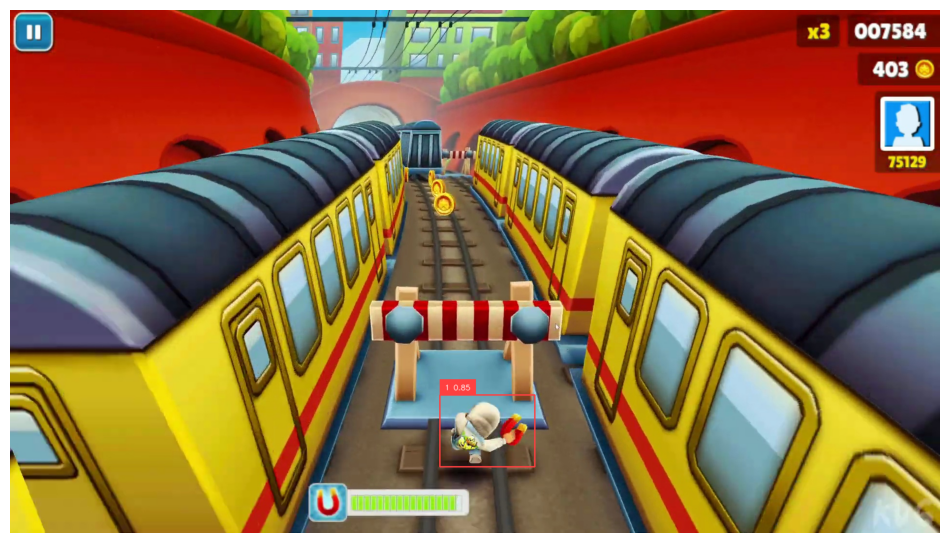

✅ Inference time: 171.03 ms

▶ Processing frame_0062.jpg on mps


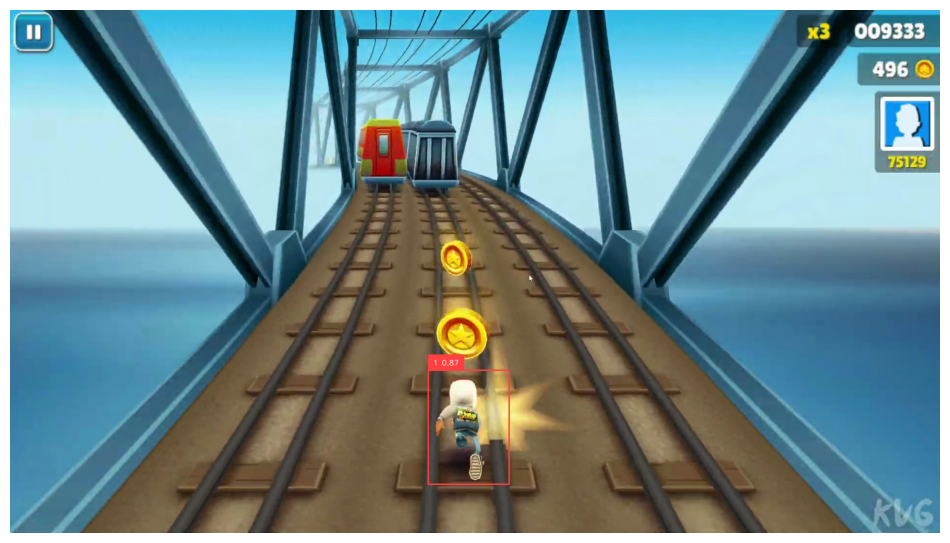

✅ Inference time: 177.32 ms

▶ Processing frame_0072.jpg on mps


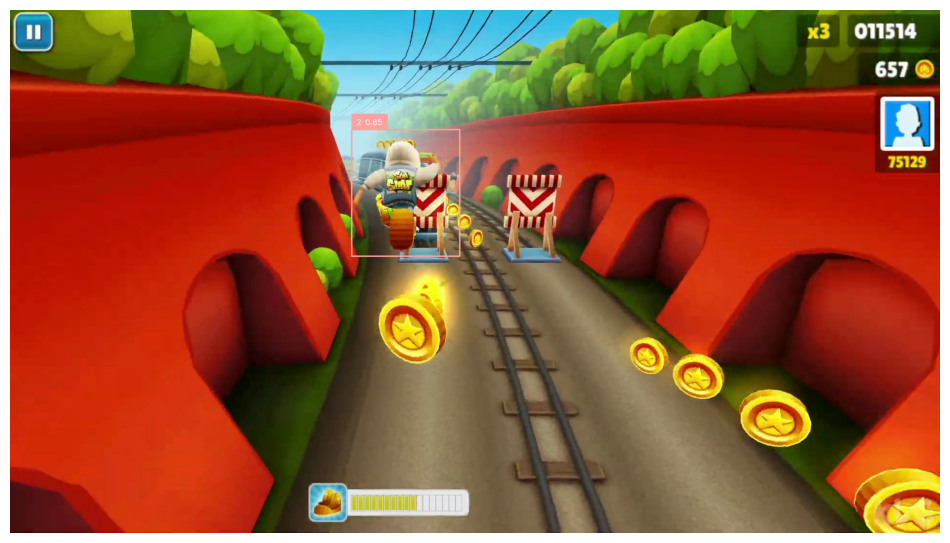

✅ Inference time: 199.30 ms

▶ Processing frame_0082.jpg on mps


KeyboardInterrupt: 

In [11]:
#!/usr/bin/env python3

import os
# Enable CPU fallback for any unsupported MPS ops
os.environ["PYTORCH_ENABLE_MPS_FALLBACK"] = "1"

import time
from PIL import Image
import torch
import torch.nn.functional as F

# Monkey-patch interpolate to disable antialiasing (avoids the unsupported bicubic-AA op on MPS)
_original_interpolate = F.interpolate
def _interpolate_no_antialias(input, *args, **kwargs):
    kwargs['antialias'] = False
    return _original_interpolate(input, *args, **kwargs)
F.interpolate = _interpolate_no_antialias

import supervision as sv
from rfdetr import RFDETRBase

# Path to your pretrained weights
weights_path = os.path.expanduser("~/downloads/weightsjake.pt")

# Pick device
device = "mps" if torch.backends.mps.is_available() else "cpu"
print(f"✅ Using device: {device}")

# Load model once (weights stay on CPU until first predict)
model = RFDETRBase(pretrain_weights=weights_path, num_classes=3)

def cycle(j, i):
    # Re-compute device in case MPS availability changes
    device = "mps" if torch.backends.mps.is_available() else "cpu"
    print(f"▶ Processing frame_00{j}{i}.jpg on {device}")

    img_path = os.path.expanduser(
        f"~/SubwaySurfers/train_screenshots/frame_00{j}{i}.jpg"
    )
    image = Image.open(img_path).convert("RGB")

    start = time.time()
    try:
        detections = model.predict(image, threshold=0.5, device=device)
    except NotImplementedError:
        print("⚠️  Falling back to CPU for this frame")
        detections = model.predict(image, threshold=0.5, device="cpu")
    elapsed_ms = (time.time() - start) * 1000

    # Annotate & display
    annotated = sv.BoxAnnotator().annotate(image, detections)
    labels = [
        f"{cid} {conf:.2f}"
        for cid, conf in zip(detections.class_id, detections.confidence)
    ]
    annotated = sv.LabelAnnotator().annotate(annotated, detections, labels)
    sv.plot_image(annotated)

    print(f"✅ Inference time: {elapsed_ms:.2f} ms\n")

if __name__ == "__main__":
    for i in range(10):
        for j in range(9):
            cycle(j, i)
